In [3]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from pathlib import Path

DATA_PATH = Path("archive/UrbanSound8K.csv")
sns.set_theme(style="whitegrid")

In [4]:
df = pd.read_csv(DATA_PATH)
print(f"Total slices: {len(df):,}")
df.head()

Total slices: 8,732


,slice_file_name,fsID,start,end,salience,fold,classID,class
0,100032-3-0-0.wav,100032,0.0,0.317551,1,5,3,dog_bark
1,100263-2-0-117.wav,100263,58.5,62.500000,1,5,2,children_playing
2,100263-2-0-121.wav,100263,60.5,64.500000,1,5,2,children_playing
3,100263-2-0-126.wav,100263,63.0,67.000000,1,5,2,children_playing
4,100263-2-0-137.wav,100263,68.5,72.500000,1,5,2,children_playing


In [5]:
summary = {
    "classes": df['class'].nunique(),
    "folds": df['fold'].nunique(),
    "duration_sec_mean": (df['end'] - df['start']).mean(),
    "duration_sec_std": (df['end'] - df['start']).std(),
}
summary

{'classes': 10,
 'folds': 10,
 'duration_sec_mean': np.float64(3.6079037445029782),
 'duration_sec_std': np.float64(0.9735702390907454)}

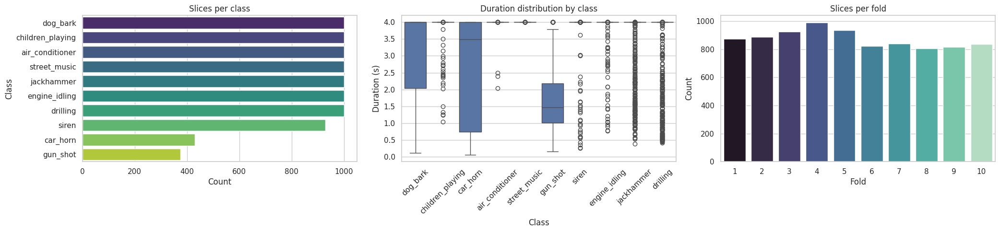

In [29]:
fig, axes = plt.subplots(1, 3, figsize=(21, 5))

class_counts = df['class'].value_counts().sort_values(ascending=False)
sns.barplot(x=class_counts.values, y=class_counts.index, ax=axes[0], palette="viridis")
axes[0].set_title("Slices per class")
axes[0].set_xlabel("Count")
axes[0].set_ylabel("Class")

sns.boxplot(data=df, x='class', y=df['end'] - df['start'], ax=axes[1])
axes[1].set_title("Duration distribution by class")
axes[1].set_xlabel("Class")
axes[1].set_ylabel("Duration (s)")
axes[1].tick_params(axis='x', rotation=45)

fold_counts = df['fold'].value_counts().sort_index()
sns.barplot(x=fold_counts.index, y=fold_counts.values, ax=axes[2], palette="mako")
axes[2].set_title("Slices per fold")
axes[2].set_xlabel("Fold")
axes[2].set_ylabel("Count")

plt.tight_layout()

#save image
plt.savefig("artifacts/summary.png")



In [11]:
import librosa
import numpy as np
from tqdm import tqdm
import warnings
import os
warnings.filterwarnings('ignore')

# Configuration
SAMPLE_RATE = 22050
N_MFCC = 128  # Number of MFCC coefficients (as in your example)

# Read metadata CSV
meta_data = pd.read_csv(DATA_PATH)
audio_dataset_path = DATA_PATH.parent

# Initialize list to store extracted features with labels
extracted = []

# Process each row in the CSV (No padding needed - using mean across time)
print("Extracting MFCC features using mean across time frames...")
for index_num, row in tqdm(meta_data.iterrows(), total=len(meta_data), desc="Processing files"):
    try:
        # Get the file path
        file_name = os.path.join(
            os.path.abspath(audio_dataset_path),
            "fold" + str(row["fold"]) + "/",
            str(row["slice_file_name"]),
        )
        
        # Get file label
        final_class_labels = row["class"]
        
        # Load the audio file
        # Note: Removed res_type="kaiser_fast" to avoid requiring resampy package
        # Using default resampling (scipy-based)
        audio, sample_rate = librosa.load(file_name, sr=SAMPLE_RATE)
        
        # Extract the features
        feature = librosa.feature.mfcc(y=audio, sr=sample_rate, n_mfcc=N_MFCC)
        # feature shape: (n_mfcc, time_frames)
        
        # Feature scaling: Take mean across time frames (no padding needed!)
        # Transpose to (time_frames, n_mfcc), then mean along axis=0 (time dimension)
        scaled_feature = np.mean(feature.T, axis=0)
        # Result: (n_mfcc,) - fixed size vector!
        
        # Store it in a list with filename for matching
        extracted.append({
            'filename': row["slice_file_name"],
            'feature': scaled_feature,
            'class': final_class_labels
        })
        
    except Exception as e:
        print(f"Error processing {row['slice_file_name']}: {e}")
        continue

print(f"\nTotal files processed: {len(extracted)}")
print(f"Feature shape per file: {extracted[0]['feature'].shape}")
print(f"Number of MFCC coefficients: {len(extracted[0]['feature'])}")


Extracting MFCC features using mean across time frames...


Processing files: 100%|██████████| 8732/8732 [01:30<00:00, 96.37it/s] 


Total files processed: 8732
Feature shape per file: (128,)
Number of MFCC coefficients: 128


In [12]:
# Create dataframe from extracted features
# No padding needed because all features have the same size (mean across time)

# Extract features, filenames, and labels from extracted list
features_array = np.array([item['feature'] for item in extracted])  # shape: (n_samples, n_mfcc)
filenames = [item['filename'] for item in extracted]
labels_array = [item['class'] for item in extracted]

# Create column names for MFCC features
mfcc_columns = [f'mfcc_{i}' for i in range(N_MFCC)]

# Create dataframe with features
features_df = pd.DataFrame(features_array, columns=mfcc_columns)
features_df['slice_file_name'] = filenames
features_df['class'] = labels_array

# Merge with original CSV to get additional metadata (fold, classID, etc.)
original_df = pd.read_csv(DATA_PATH)
final_df = features_df.merge(original_df[['slice_file_name', 'fold', 'classID', 'start', 'end', 'salience']], 
                             on='slice_file_name', how='inner')

# Reorder columns: metadata first, then features
column_order = ['slice_file_name', 'fold', 'class', 'classID', 'start', 'end', 'salience'] + mfcc_columns
final_df = final_df[column_order]

# Display summary
print(f"Dataframe shape: {final_df.shape}")
print(f"\nDataframe columns: {len(final_df.columns)} (metadata: 7, features: {len(mfcc_columns)})")
print(f"\nFeature size is fixed: {len(mfcc_columns)} features (NO PADDING NEEDED!)")
print(f"\nFirst few rows:")
final_df.head()


Dataframe shape: (8732, 135)

Dataframe columns: 135 (metadata: 7, features: 128)

Feature size is fixed: 128 features (NO PADDING NEEDED!)

First few rows:


,slice_file_name,fold,class,classID,start,end,salience,mfcc_0,mfcc_1,mfcc_2,...,mfcc_118,mfcc_119,mfcc_120,mfcc_121,mfcc_122,mfcc_123,mfcc_124,mfcc_125,mfcc_126,mfcc_127
0,100032-3-0-0.wav,5,dog_bark,3,0.0,0.317551,1,-211.936981,62.581211,-122.813156,...,1.245350,0.334247,-0.518073,-0.582462,-0.426687,0.031856,-0.694172,0.665087,-0.473492,0.266806
1,100263-2-0-117.wav,5,children_playing,2,58.5,62.500000,1,-417.005188,99.336624,-42.995583,...,0.085278,-0.541269,-0.281309,-0.257986,0.135340,0.317946,0.098458,-0.447696,-0.001581,-0.392334
2,100263-2-0-121.wav,5,children_playing,2,60.5,64.500000,1,-452.393158,112.362534,-37.578072,...,-0.106640,0.412547,0.036087,-0.055620,-0.176766,-0.346032,-0.013514,0.377253,0.122620,-0.071227
3,100263-2-0-126.wav,5,children_playing,2,63.0,67.000000,1,-406.479218,91.196602,-25.043556,...,0.096881,-0.002160,0.192709,0.071517,-0.018736,0.216474,0.055830,-0.154501,-0.332152,0.225868
4,100263-2-0-137.wav,5,children_playing,2,68.5,72.500000,1,-439.638733,103.862228,-42.658787,...,-0.067966,0.023483,-0.166277,0.272428,0.030808,0.408810,0.188192,0.031398,0.187501,0.461869


Extracted features dataframe saved to: artifacts/extracted_df.pkl
Dataframe shape: (8732, 2)


,feature,class
0,"[-211.93698, 62.58121, -122.813156, -60.745293...",dog_bark
1,"[-417.0052, 99.336624, -42.995583, 51.073326, ...",children_playing
2,"[-452.39316, 112.36253, -37.57807, 43.195866, ...",children_playing
3,"[-406.47922, 91.1966, -25.043556, 42.78452, 11...",children_playing
4,"[-439.63873, 103.86223, -42.658787, 50.690285,...",children_playing


In [14]:
# Data Preprocessing
# Import required libraries
import torch
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split

# Distribute the data to X and Y
# Using extracted_df (or final_df) - both have 'feature' and 'class' columns
# Using extracted_df as it has the clean feature/class format
X = np.array(extracted_df["feature"].tolist())
y = np.array(extracted_df["class"].tolist())

print(f"X shape: {X.shape}")
print(f"y shape: {y.shape}")
print(f"Number of unique classes: {len(np.unique(y))}")
print(f"Classes: {np.unique(y)}")


X shape: (8732, 128)
y shape: (8732,)
Number of unique classes: 10
Classes: ['air_conditioner' 'car_horn' 'children_playing' 'dog_bark' 'drilling'
 'engine_idling' 'gun_shot' 'jackhammer' 'siren' 'street_music']


In [15]:
# Using LabelEncoder() to encode the string labels to integers
# Label encoding to get integer encoding
le = LabelEncoder()

# Transform each category with its respected integer label
y_encoded = le.fit_transform(y)

# Print label encoding mapping
print("Label encoding mapping:")
for i, class_name in enumerate(le.classes_):
    print(f"  {class_name} -> {i}")

# Convert to categorical (one-hot encoding) using PyTorch
# PyTorch approach: torch.nn.functional.one_hot()
num_classes = len(le.classes_)
y_tensor = torch.LongTensor(y_encoded)  # Convert to PyTorch tensor
Y = torch.nn.functional.one_hot(y_tensor, num_classes=num_classes).numpy()

print(f"\nOriginal y shape: {y.shape}")
print(f"Encoded y shape: {y_encoded.shape}")
print(f"Categorical Y shape: {Y.shape}")
print(f"Number of classes: {num_classes}")

# Note: For PyTorch training, you can also use integer labels directly with CrossEntropyLoss
# If you want to keep integer labels instead of one-hot:
# y_train_int = torch.LongTensor(y_train_encoded)  # for training


Label encoding mapping:
  air_conditioner -> 0
  car_horn -> 1
  children_playing -> 2
  dog_bark -> 3
  drilling -> 4
  engine_idling -> 5
  gun_shot -> 6
  jackhammer -> 7
  siren -> 8
  street_music -> 9

Original y shape: (8732,)
Encoded y shape: (8732,)
Categorical Y shape: (8732, 10)
Number of classes: 10


In [16]:
# Split the data into train and test sets
# Split the data to train and test set
X_train, X_test, y_train, y_test = train_test_split(
    X, Y, test_size=0.2, random_state=42
)

# Print the details
print("Number of training samples = ", X_train.shape[0])
print("Number of testing samples = ", X_test.shape[0])
print(f"\nTraining set:")
print(f"  X_train shape: {X_train.shape}")
print(f"  y_train shape: {y_train.shape}")
print(f"\nTesting set:")
print(f"  X_test shape: {X_test.shape}")
print(f"  y_test shape: {y_test.shape}")


Number of training samples =  6985
Number of testing samples =  1747

Training set:
  X_train shape: (6985, 128)
  y_train shape: (6985, 10)

Testing set:
  X_test shape: (1747, 128)
  y_test shape: (1747, 10)


In [17]:
# Optional: Save the label encoder for later use (inference/prediction)
import pickle as pkl

label_encoder_path = Path("artifacts/label_encoder.pkl")
label_encoder_path.parent.mkdir(parents=True, exist_ok=True)

with open(label_encoder_path, 'wb') as f:
    pkl.dump(le, f)
    
print(f"Label encoder saved to: {label_encoder_path}")
print("You can load it later with: le = pkl.load(open('artifacts/label_encoder.pkl', 'rb'))")


Label encoder saved to: artifacts/label_encoder.pkl
You can load it later with: le = pkl.load(open('artifacts/label_encoder.pkl', 'rb'))


In [18]:
# Convert to PyTorch tensors for training
# PyTorch models typically work with tensors instead of numpy arrays

# Convert X (features) to PyTorch tensors
X_train_tensor = torch.FloatTensor(X_train)
X_test_tensor = torch.FloatTensor(X_test)

# For labels, PyTorch's CrossEntropyLoss works with integer labels (LongTensor)
# So we can use y_encoded instead of one-hot encoding
# Get the corresponding y_encoded for train/test sets (same split as X, Y)
_, _, y_train_encoded, y_test_encoded = train_test_split(
    X, y_encoded, test_size=0.2, random_state=42
)

y_train_tensor = torch.LongTensor(y_train_encoded)
y_test_tensor = torch.LongTensor(y_test_encoded)

print("PyTorch Tensors created:")
print(f"  X_train_tensor shape: {X_train_tensor.shape}, dtype: {X_train_tensor.dtype}")
print(f"  X_test_tensor shape: {X_test_tensor.shape}, dtype: {X_test_tensor.dtype}")
print(f"  y_train_tensor shape: {y_train_tensor.shape}, dtype: {y_train_tensor.dtype} (for CrossEntropyLoss)")
print(f"  y_test_tensor shape: {y_test_tensor.shape}, dtype: {y_test_tensor.dtype} (for CrossEntropyLoss)")
print(f"\nNote: Using integer labels with CrossEntropyLoss (PyTorch standard)")


PyTorch Tensors created:
  X_train_tensor shape: torch.Size([6985, 128]), dtype: torch.float32
  X_test_tensor shape: torch.Size([1747, 128]), dtype: torch.float32
  y_train_tensor shape: torch.Size([6985]), dtype: torch.int64 (for CrossEntropyLoss)
  y_test_tensor shape: torch.Size([1747]), dtype: torch.int64 (for CrossEntropyLoss)

Note: Using integer labels with CrossEntropyLoss (PyTorch standard)


## ANN (Artificial Neural Network)

In [20]:
# Model 1 - ANN (Artificial Neural Network)
# Building the model using PyTorch

import time
from torch import nn
import torch.optim as optim

# Get number of classes
num_labels = len(le.classes_)
input_features = 128  # MFCC features

# Define ANN Model using PyTorch Sequential
# Note: No Softmax at the end - CrossEntropyLoss will handle it
ANN_Model = nn.Sequential(
    nn.Linear(input_features, 1000),
    nn.ReLU(),
    nn.Linear(1000, 750),
    nn.ReLU(),
    nn.Linear(750, 500),
    nn.ReLU(),
    nn.Linear(500, 250),
    nn.ReLU(),
    nn.Linear(250, 100),
    nn.ReLU(),
    nn.Linear(100, 50),
    nn.ReLU(),
    nn.Linear(50, num_labels)
)

# Print model summary
print("ANN Model Architecture:")
print(ANN_Model)
print("\n" + "="*50)

# Count parameters
total_params = sum(p.numel() for p in ANN_Model.parameters())
trainable_params = sum(p.numel() for p in ANN_Model.parameters() if p.requires_grad)
print(f"\nTotal params: {total_params:,}")
print(f"Trainable params: {trainable_params:,}")
print(f"Non-trainable params: {total_params - trainable_params:,}")

# Compiling the model (PyTorch equivalent)
# Note: In PyTorch, we don't "compile" like Keras, we define loss and optimizer separately
print("\n" + "="*50)
print("Compiling the model...")

# Define loss function for multi-class classification
# CrossEntropyLoss expects raw logits (no softmax) and integer class labels (not one-hot)
# This is equivalent to categorical_crossentropy in Keras/TensorFlow
criterion = nn.CrossEntropyLoss()

# Define optimizer (Adam optimizer)
# Adam is a popular adaptive learning rate optimization algorithm
optimizer = optim.Adam(ANN_Model.parameters(), lr=0.001)  # Default learning rate

print("Model compiled:")
print(f"  Loss function: CrossEntropyLoss (for multi-class classification)")
print(f"    - Equivalent to categorical_crossentropy in Keras")
print(f"    - Works with integer class labels (not one-hot encoding)")
print(f"    - Includes LogSoftmax internally, so no Softmax needed in model")
print(f"  Optimizer: Adam (learning_rate=0.001)")
print(f"  Model ready for training!")


ANN Model Architecture:
Sequential(
  (0): Linear(in_features=128, out_features=1000, bias=True)
  (1): ReLU()
  (2): Linear(in_features=1000, out_features=750, bias=True)
  (3): ReLU()
  (4): Linear(in_features=750, out_features=500, bias=True)
  (5): ReLU()
  (6): Linear(in_features=500, out_features=250, bias=True)
  (7): ReLU()
  (8): Linear(in_features=250, out_features=100, bias=True)
  (9): ReLU()
  (10): Linear(in_features=100, out_features=50, bias=True)
  (11): ReLU()
  (12): Linear(in_features=50, out_features=10, bias=True)
)


Total params: 1,411,160
Trainable params: 1,411,160
Non-trainable params: 0

Compiling the model...
Model compiled:
  Loss function: CrossEntropyLoss (for multi-class classification)
    - Equivalent to categorical_crossentropy in Keras
    - Works with integer class labels (not one-hot encoding)
    - Includes LogSoftmax internally, so no Softmax needed in model
  Optimizer: Adam (learning_rate=0.001)
  Model ready for training!


In [21]:
# Fitting the model (Training)
num_epochs = 250
num_batch_size = 32

# Initialize training history
train_losses = []
train_accuracies = []
val_losses = []
val_accuracies = []

# Start training timer
t0 = time.time()

print(f"Training ANN Model for {num_epochs} epochs...")
print(f"Batch size: {num_batch_size}")
print(f"Training samples: {len(X_train_tensor)}, Validation samples: {len(X_test_tensor)}")
print("="*60)

for epoch in range(num_epochs):
    # Training phase
    ANN_Model.train()
    train_loss = 0.0
    train_correct = 0
    train_total = 0
    
    # Mini-batch training
    for i in range(0, len(X_train_tensor), num_batch_size):
        # Get batch
        batch_X = X_train_tensor[i:i+num_batch_size]
        batch_y = y_train_tensor[i:i+num_batch_size]
        
        # Forward pass
        optimizer.zero_grad()
        outputs = ANN_Model(batch_X)
        loss = criterion(outputs, batch_y)
        
        # Backward pass
        loss.backward()
        optimizer.step()
        
        # Calculate accuracy
        train_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        train_total += batch_y.size(0)
        train_correct += (predicted == batch_y).sum().item()
    
    # Calculate average training metrics
    avg_train_loss = train_loss / (len(X_train_tensor) // num_batch_size + 1)
    train_accuracy = 100 * train_correct / train_total
    train_losses.append(avg_train_loss)
    train_accuracies.append(train_accuracy)
    
    # Validation phase
    ANN_Model.eval()
    val_loss = 0.0
    val_correct = 0
    val_total = 0
    
    with torch.no_grad():
        for i in range(0, len(X_test_tensor), num_batch_size):
            batch_X = X_test_tensor[i:i+num_batch_size]
            batch_y = y_test_tensor[i:i+num_batch_size]
            
            outputs = ANN_Model(batch_X)
            loss = criterion(outputs, batch_y)
            
            val_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            val_total += batch_y.size(0)
            val_correct += (predicted == batch_y).sum().item()
    
    avg_val_loss = val_loss / (len(X_test_tensor) // num_batch_size + 1)
    val_accuracy = 100 * val_correct / val_total
    val_losses.append(avg_val_loss)
    val_accuracies.append(val_accuracy)
    
    # Print progress every 25 epochs
    if (epoch + 1) % 25 == 0 or epoch == 0:
        print(f"Epoch [{epoch+1}/{num_epochs}]")
        print(f"  Train Loss: {avg_train_loss:.4f}, Train Acc: {train_accuracy:.2f}%")
        print(f"  Val Loss: {avg_val_loss:.4f}, Val Acc: {val_accuracy:.2f}%")
        print("-"*60)

# Calculate total training time
train_m1 = round(time.time() - t0, 3)
print(f"\nTraining completed in {train_m1} seconds")

# Create history dataframe (similar to Keras)
ANN_Results = {
    'loss': train_losses,
    'accuracy': [acc/100 for acc in train_accuracies],  # Convert to [0,1] range
    'val_loss': val_losses,
    'val_accuracy': [acc/100 for acc in val_accuracies]
}
train_hist_m1 = pd.DataFrame(ANN_Results)


Training ANN Model for 250 epochs...
Batch size: 32
Training samples: 6985, Validation samples: 1747
Epoch [1/250]
  Train Loss: 1.6867, Train Acc: 38.20%
  Val Loss: 1.2912, Val Acc: 58.39%
------------------------------------------------------------
Epoch [25/250]
  Train Loss: 0.0795, Train Acc: 97.70%
  Val Loss: 0.3979, Val Acc: 93.07%
------------------------------------------------------------
Epoch [50/250]
  Train Loss: 0.0211, Train Acc: 99.33%
  Val Loss: 0.5488, Val Acc: 94.05%
------------------------------------------------------------
Epoch [75/250]
  Train Loss: 0.0981, Train Acc: 97.11%
  Val Loss: 0.6157, Val Acc: 93.02%
------------------------------------------------------------
Epoch [100/250]
  Train Loss: 0.0045, Train Acc: 99.71%
  Val Loss: 0.4955, Val Acc: 94.62%
------------------------------------------------------------
Epoch [125/250]
  Train Loss: 0.0070, Train Acc: 99.74%
  Val Loss: 0.8001, Val Acc: 94.33%
-----------------------------------------------

In [22]:
# Save the model
model_path = Path("artifacts/Model1.pth")
model_path.parent.mkdir(parents=True, exist_ok=True)

# Save model state dict (recommended PyTorch way)
torch.save(ANN_Model.state_dict(), model_path)
print(f"ANN Model saved to: {model_path}")

# Optional: Save entire model (less portable but simpler)
# torch.save(ANN_Model, "artifacts/Model1_full.pth")

# Save training history
history_path = Path("artifacts/ANN_training_history.csv")
train_hist_m1.to_csv(history_path, index=False)
print(f"Training history saved to: {history_path}")

print(f"\nTraining summary:")
print(f"  Final train accuracy: {train_accuracies[-1]:.2f}%")
print(f"  Final validation accuracy: {val_accuracies[-1]:.2f}%")
print(f"  Total training time: {train_m1} seconds")


ANN Model saved to: artifacts/Model1.pth
Training history saved to: artifacts/ANN_training_history.csv

Training summary:
  Final train accuracy: 94.75%
  Final validation accuracy: 89.98%
  Total training time: 1185.516 seconds


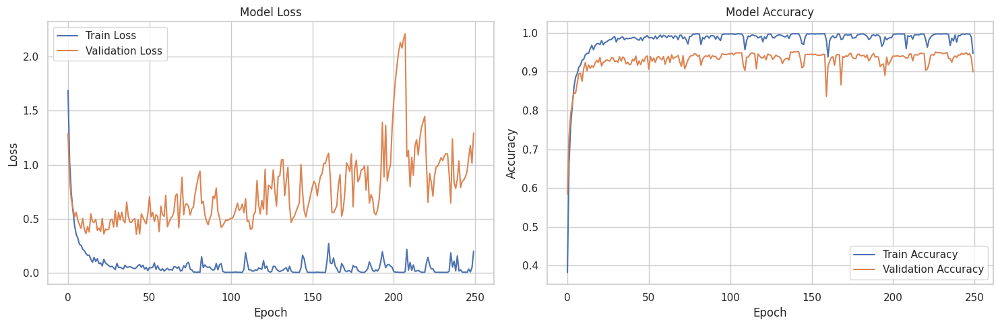


Final Training Metrics:
  Train Loss: 0.2010
  Train Accuracy: 94.75%
  Validation Loss: 1.2938
  Validation Accuracy: 89.98%


In [23]:
# Plot training history (similar to Keras)
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

# Plot loss
axes[0].plot(train_hist_m1['loss'], label='Train Loss')
axes[0].plot(train_hist_m1['val_loss'], label='Validation Loss')
axes[0].set_title('Model Loss')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend()
axes[0].grid(True)

# Plot accuracy
axes[1].plot(train_hist_m1['accuracy'], label='Train Accuracy')
axes[1].plot(train_hist_m1['val_accuracy'], label='Validation Accuracy')
axes[1].set_title('Model Accuracy')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Accuracy')
axes[1].legend()
axes[1].grid(True)

plt.tight_layout()
plt.show()

# Display final metrics
print("\nFinal Training Metrics:")
print(f"  Train Loss: {train_hist_m1['loss'].iloc[-1]:.4f}")
print(f"  Train Accuracy: {train_hist_m1['accuracy'].iloc[-1]*100:.2f}%")
print(f"  Validation Loss: {train_hist_m1['val_loss'].iloc[-1]:.4f}")
print(f"  Validation Accuracy: {train_hist_m1['val_accuracy'].iloc[-1]*100:.2f}%")


In [24]:
# Evaluate the model on test set (PyTorch equivalent of model.evaluate())
# Define log columns for comparison
log_cols = ["Model", "Accuracy (%)", "Training Time (s)", "Prediction Time (s)"]

# Evaluate model
ANN_Model.eval()
test_loss = 0.0
test_correct = 0
test_total = 0

t0 = time.time()
with torch.no_grad():
    for i in range(0, len(X_test_tensor), num_batch_size):
        batch_X = X_test_tensor[i:i+num_batch_size]
        batch_y = y_test_tensor[i:i+num_batch_size]
        
        outputs = ANN_Model(batch_X)
        loss = criterion(outputs, batch_y)
        
        test_loss += loss.item()
        _, predicted = torch.max(outputs.data, 1)
        test_total += batch_y.size(0)
        test_correct += (predicted == batch_y).sum().item()

acc_m1 = test_correct / test_total  # Accuracy as percentage (0-1)
eval_time = round(time.time() - t0, 3)

print("Model Evaluation on Test Set:")
print(f"  Test Loss: {test_loss / (len(X_test_tensor) // num_batch_size + 1):.4f}")
print(f"  Test Accuracy: {acc_m1 * 100:.2f}%")
print(f"  Evaluation Time: {eval_time} seconds")


Model Evaluation on Test Set:
  Test Loss: 1.2938
  Test Accuracy: 89.98%
  Evaluation Time: 0.033 seconds


In [25]:
# Predict on test set (PyTorch equivalent of model.predict())
ANN_Model.eval()

t0 = time.time()
y_pred_m1_list = []

with torch.no_grad():
    for i in range(0, len(X_test_tensor), num_batch_size):
        batch_X = X_test_tensor[i:i+num_batch_size]
        outputs = ANN_Model(batch_X)
        # Apply softmax to get probabilities
        probs = torch.nn.functional.softmax(outputs, dim=1)
        # Get predicted class indices
        _, predicted = torch.max(outputs, 1)
        y_pred_m1_list.extend(predicted.cpu().numpy())

y_pred_m1 = np.array(y_pred_m1_list)
pred_m1 = round(time.time() - t0, 3)

print(f"Predictions completed in {pred_m1} seconds")
print(f"Predictions shape: {y_pred_m1.shape}")
print(f"Sample predictions: {y_pred_m1[:10]}")

# Create log entry
log_entry = pd.DataFrame(
    [["ANN", acc_m1 * 100, train_m1, pred_m1]], 
    columns=log_cols
)

# Initialize log dataframe if it doesn't exist
if 'log' not in globals():
    log = log_entry.copy()
else:
    log = pd.concat([log, log_entry], ignore_index=True)

print("\nModel Log Entry:")
print(log)


Predictions completed in 0.095 seconds
Predictions shape: (1747,)
Sample predictions: [8 9 4 8 3 7 2 3 4 3]

Model Log Entry:
  Model  Accuracy (%)  Training Time (s)  Prediction Time (s)
0   ANN     89.982828           1185.516                0.095


In [ ]:
# ANN Prediction Function 
def ANN_Prediction(file_name):
    """
    Predict class label for an audio file using the trained ANN model.
    
    Args:
        file_name: Path to the audio file (.wav format)
    
    Returns:
        predicted_class: Predicted class name as string
        probabilities: Class probabilities as numpy array
    """
    # Load the audio file
    # Note: Using default resampling (not kaiser_fast to avoid resampy dependency)
    audio_data, sample_rate = librosa.load(file_name, sr=SAMPLE_RATE)
    
    # Extract MFCC features
    feature = librosa.feature.mfcc(y=audio_data, sr=sample_rate, n_mfcc=N_MFCC)
    # feature shape: (n_mfcc, time_frames)
    
    # Scale the features: Take mean across time frames
    feature_scaled = np.mean(feature.T, axis=0)
    # Result: (n_mfcc,) - fixed size vector!
    
    # Convert to numpy array and reshape for model input
    prediction_feature = np.array([feature_scaled])  # Shape: (1, 128)
    
    # Convert to PyTorch tensor
    prediction_tensor = torch.FloatTensor(prediction_feature)
    
    # Predict using the model
    ANN_Model.eval()
    with torch.no_grad():
        outputs = ANN_Model(prediction_tensor)
        # Apply softmax to get probabilities
        probabilities = torch.nn.functional.softmax(outputs, dim=1)
        # Get predicted class index (argmax)
        _, predicted_index = torch.max(outputs, 1)
        predicted_index = predicted_index.item()  # Convert to Python int
    
    # Get class probabilities as numpy array
    probs_numpy = probabilities.cpu().numpy()[0]
    
    # Get the class label from class id using label encoder
    predicted_class = le.inverse_transform([predicted_index])[0]
    
    # Display the result
    print(f"ANN has predicted the class as --> {predicted_class}")
    print(f"Prediction confidence: {probs_numpy[predicted_index]*100:.2f}%")
    print(f"\nAll class probabilities:")
    for i, class_name in enumerate(le.classes_):
        print(f"  {class_name}: {probs_numpy[i]*100:.2f}%")
    
    return predicted_class, probs_numpy

print("ANN Prediction Function defined successfully!")


ANN Prediction Function defined successfully!


In [28]:
# Testing the Model on 10 Sample Audio Files
import random
import IPython.display as ipd

# Number of samples to test
num_samples = 20

# Get all audio files from the dataset
print("Collecting sample audio files from the dataset...")
all_audio_files = []
for fold_num in range(1, 11):  # Check all folds
    fold_path = os.path.join(str(audio_dataset_path), f"fold{fold_num}")
    if os.path.exists(fold_path):
        wav_files = [f for f in os.listdir(fold_path) if f.endswith('.wav')]
        for wav_file in wav_files:
            full_path = os.path.join(fold_path, wav_file)
            # Get the actual class from metadata if available
            matching_row = meta_data[meta_data['slice_file_name'] == wav_file]
            if not matching_row.empty:
                actual_class = matching_row.iloc[0]['class']
                all_audio_files.append((full_path, actual_class, wav_file))

if len(all_audio_files) == 0:
    print("No audio files found in the dataset!")
else:
    # Randomly select num_samples files
    selected_files = random.sample(all_audio_files, min(num_samples, len(all_audio_files)))
    
    print(f"\nTesting on {len(selected_files)} randomly selected audio files:")
    print("="*80)
    
    correct_predictions = 0
    results = []
    
    for idx, (file_path, actual_class, filename) in enumerate(selected_files, 1):
        print(f"\n{'='*80}")
        print(f"Sample {idx}/{len(selected_files)}: {filename}")
        print(f"Actual Class: {actual_class}")
        print(f"File Path: {file_path}")
        print("-"*80)
        
        # Get the prediction
        try:
            predicted_class, probabilities = ANN_Prediction(file_path)
            
            # Check if prediction is correct
            is_correct = (predicted_class == actual_class)
            if is_correct:
                correct_predictions += 1
                status = "✓ CORRECT"
            else:
                status = "✗ INCORRECT"
            
            print(f"\nStatus: {status}")
            print(f"Actual: {actual_class} | Predicted: {predicted_class}")
            
            results.append({
                'Sample': idx,
                'Filename': filename,
                'Actual Class': actual_class,
                'Predicted Class': predicted_class,
                'Correct': is_correct,
                'Confidence': probabilities[le.transform([predicted_class])[0]] * 100
            })
            
            # Play the audio file
            print(f"\n🎵 Playing audio...")
            ipd.display(ipd.Audio(file_path))
            print("-"*80)
            
        except Exception as e:
            print(f"Error processing {filename}: {e}")
            results.append({
                'Sample': idx,
                'Filename': filename,
                'Actual Class': actual_class,
                'Predicted Class': 'ERROR',
                'Correct': False,
                'Confidence': 0
            })
    
    # Print summary
    print(f"\n{'='*80}")
    print("TESTING SUMMARY")
    print(f"{'='*80}")
    print(f"Total Samples Tested: {len(selected_files)}")
    print(f"Correct Predictions: {correct_predictions}")
    print(f"Incorrect Predictions: {len(selected_files) - correct_predictions}")
    print(f"Accuracy: {correct_predictions/len(selected_files)*100:.2f}%")
    
    # Create results dataframe
    results_df = pd.DataFrame(results)
    print(f"\nDetailed Results:")
    print(results_df.to_string(index=False))



Testing on 20 randomly selected audio files:

Sample 1/20: 128030-3-1-0.wav
Actual Class: dog_bark
File Path: archive/fold3/128030-3-1-0.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> dog_bark
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 0.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 100.00%
  drilling: 0.00%
  engine_idling: 0.00%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: dog_bark | Predicted: dog_bark

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 2/20: 176638-5-0-2.wav
Actual Class: engine_idling
File Path: archive/fold4/176638-5-0-2.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> engine_idling
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 0.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 100.00%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: engine_idling | Predicted: engine_idling

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 3/20: 147926-0-0-27.wav
Actual Class: air_conditioner
File Path: archive/fold2/147926-0-0-27.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> air_conditioner
Prediction confidence: 99.38%

All class probabilities:
  air_conditioner: 99.38%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 0.59%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 0.03%

Status: ✓ CORRECT
Actual: air_conditioner | Predicted: air_conditioner

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 4/20: 63724-0-0-6.wav
Actual Class: air_conditioner
File Path: archive/fold6/63724-0-0-6.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> air_conditioner
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 100.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 0.00%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: air_conditioner | Predicted: air_conditioner

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 5/20: 117271-3-0-1.wav
Actual Class: dog_bark
File Path: archive/fold6/117271-3-0-1.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> dog_bark
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 0.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 100.00%
  drilling: 0.00%
  engine_idling: 0.00%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: dog_bark | Predicted: dog_bark

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 6/20: 33340-7-15-0.wav
Actual Class: jackhammer
File Path: archive/fold8/33340-7-15-0.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> jackhammer
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 0.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 0.00%
  gun_shot: 0.00%
  jackhammer: 100.00%
  siren: 0.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: jackhammer | Predicted: jackhammer

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 7/20: 104327-2-0-3.wav
Actual Class: children_playing
File Path: archive/fold6/104327-2-0-3.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> children_playing
Prediction confidence: 99.92%

All class probabilities:
  air_conditioner: 0.04%
  car_horn: 0.00%
  children_playing: 99.92%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 0.01%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 0.03%

Status: ✓ CORRECT
Actual: children_playing | Predicted: children_playing

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 8/20: 195969-0-0-15.wav
Actual Class: air_conditioner
File Path: archive/fold4/195969-0-0-15.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> air_conditioner
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 100.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 0.00%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: air_conditioner | Predicted: air_conditioner

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 9/20: 113205-5-1-4.wav
Actual Class: engine_idling
File Path: archive/fold1/113205-5-1-4.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> engine_idling
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 0.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 100.00%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: engine_idling | Predicted: engine_idling

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 10/20: 197318-6-7-0.wav
Actual Class: gun_shot
File Path: archive/fold1/197318-6-7-0.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> gun_shot
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 0.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 0.00%
  gun_shot: 100.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: gun_shot | Predicted: gun_shot

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 11/20: 56385-0-0-1.wav
Actual Class: air_conditioner
File Path: archive/fold2/56385-0-0-1.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> air_conditioner
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 100.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 0.00%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: air_conditioner | Predicted: air_conditioner

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 12/20: 13230-0-0-14.wav
Actual Class: air_conditioner
File Path: archive/fold3/13230-0-0-14.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> air_conditioner
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 100.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 0.00%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: air_conditioner | Predicted: air_conditioner

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 13/20: 94636-8-0-5.wav
Actual Class: siren
File Path: archive/fold3/94636-8-0-5.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> siren
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 0.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 0.00%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 100.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: siren | Predicted: siren

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 14/20: 197554-2-0-28.wav
Actual Class: children_playing
File Path: archive/fold10/197554-2-0-28.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> children_playing
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 0.00%
  car_horn: 0.00%
  children_playing: 100.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 0.00%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: children_playing | Predicted: children_playing

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 15/20: 111671-8-0-12.wav
Actual Class: siren
File Path: archive/fold5/111671-8-0-12.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> siren
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 0.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 0.00%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 100.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: siren | Predicted: siren

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 16/20: 176714-2-0-33.wav
Actual Class: children_playing
File Path: archive/fold1/176714-2-0-33.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> children_playing
Prediction confidence: 71.32%

All class probabilities:
  air_conditioner: 5.71%
  car_horn: 0.01%
  children_playing: 71.32%
  dog_bark: 1.01%
  drilling: 0.03%
  engine_idling: 13.92%
  gun_shot: 0.10%
  jackhammer: 0.00%
  siren: 0.84%
  street_music: 7.07%

Status: ✓ CORRECT
Actual: children_playing | Predicted: children_playing

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 17/20: 128160-5-0-14.wav
Actual Class: engine_idling
File Path: archive/fold4/128160-5-0-14.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> engine_idling
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 0.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 100.00%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: engine_idling | Predicted: engine_idling

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 18/20: 98680-9-0-5.wav
Actual Class: street_music
File Path: archive/fold6/98680-9-0-5.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> street_music
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 0.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 0.00%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 100.00%

Status: ✓ CORRECT
Actual: street_music | Predicted: street_music

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 19/20: 17009-2-0-0.wav
Actual Class: children_playing
File Path: archive/fold8/17009-2-0-0.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> children_playing
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 0.00%
  car_horn: 0.00%
  children_playing: 100.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 0.00%
  gun_shot: 0.00%
  jackhammer: 0.00%
  siren: 0.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: children_playing | Predicted: children_playing

🎵 Playing audio...


--------------------------------------------------------------------------------

Sample 20/20: 62837-7-1-73.wav
Actual Class: jackhammer
File Path: archive/fold3/62837-7-1-73.wav
--------------------------------------------------------------------------------
ANN has predicted the class as --> jackhammer
Prediction confidence: 100.00%

All class probabilities:
  air_conditioner: 0.00%
  car_horn: 0.00%
  children_playing: 0.00%
  dog_bark: 0.00%
  drilling: 0.00%
  engine_idling: 0.00%
  gun_shot: 0.00%
  jackhammer: 100.00%
  siren: 0.00%
  street_music: 0.00%

Status: ✓ CORRECT
Actual: jackhammer | Predicted: jackhammer

🎵 Playing audio...


--------------------------------------------------------------------------------

TESTING SUMMARY
Total Samples Tested: 20
Correct Predictions: 20
Incorrect Predictions: 0
Accuracy: 100.00%

Detailed Results:
 Sample          Filename     Actual Class  Predicted Class  Correct  Confidence
      1  128030-3-1-0.wav         dog_bark         dog_bark     True  100.000000
      2  176638-5-0-2.wav    engine_idling    engine_idling     True   99.998451
      3 147926-0-0-27.wav  air_conditioner  air_conditioner     True   99.380836
      4   63724-0-0-6.wav  air_conditioner  air_conditioner     True  100.000000
      5  117271-3-0-1.wav         dog_bark         dog_bark     True  100.000000
      6  33340-7-15-0.wav       jackhammer       jackhammer     True  100.000000
      7  104327-2-0-3.wav children_playing children_playing     True   99.916664
      8 195969-0-0-15.wav  air_conditioner  air_conditioner     True  100.000000
      9  113205-5-1-4.wav    engine_idling    engine_idling   